## 키보드 이벤트 처리

In [1]:
import numpy as np
import cv2

In [8]:
width, height = 512, 512
x, y = width//2, height//2
R = 50

direction = 0  # 0:right, 1:down, 2:left, 3:up

while True:
    key = cv2.waitKeyEx(30)
    if key == 0x1B: # ESC
        break
        
    # 방향키처리
    elif key == 0x270000: # right
        direction = 0
    elif key == 0x280000: # down
        direction = 1
    elif key == 0x250000: # left
        direction = 2
    elif key == 0x260000: # up
        direction = 3

    # 방향에 맞게 x, y 좌표 설정
    if direction == 0:
        x += 10 # 픽셀
    elif direction == 1:
        y += 10 
    elif direction == 2:
        x -= 10
    else:
        y -= 10
        
    # 경계 확인
    if x < R:
        x = R
        direction = 0
    if x > width - R:
        x = width - R
        direction = 2
        
    if y < R:
        y = R
        direction = 1
    if y > height - R:
        y = height - R
        direction = 3
    
    
    # 지우기, 그리기
    img = np.zeros((width, height, 3), np.uint8) + 255
    
    cv2.circle(img, (x, y), R, (0, 0, 255), -1)
    cv2.imshow('img', img)

    
cv2.destroyAllWindows()

## 마우스 이벤트 처리

In [10]:
img = np.zeros((512, 512, 3), np.uint8) + 255

def onMouse(event, x, y, flags, param):
    if event == cv2.EVENT_LBUTTONDOWN:
        if flags & cv2.EVENT_FLAG_SHIFTKEY: # 마우스 이벤트는 event로 받고 그 외 키보드 이벤트 같은 것들은 flags로 받음
            cv2.rectangle(param[0], (x-5, y-5), (x+5, y+5), (0, 255, 0))
        else:
            cv2.circle(param[0], (x, y), 5, (255, 0, 0), 3)
    
    elif event == cv2.EVENT_RBUTTONDOWN:
        cv2.circle(param[0], (x, y), 5, (0, 0, 255), 3)
        
    elif event == cv2.EVENT_LBUTTONDBLCLK:
        param[0] = np.zeros((512, 512, 3), np.uint8) + 255
        
    cv2.imshow('img', param[0])

cv2.imshow('img', img)

cv2.setMouseCallback('img', onMouse, [img])
cv2.waitKey()
cv2.destroyAllWindows()

## 트랙바 이벤트 처리

In [11]:
def onChange(pos):
    global img
    r = cv2.getTrackbarPos('R', 'img')
    g = cv2.getTrackbarPos('G', 'img')
    b = cv2.getTrackbarPos('B', 'img')
    
    img[:] = (b, g, r)
    cv2.imshow('img', img)

img = np.zeros((512, 512, 3), np.uint8) + 255
cv2.imshow('img', img)

cv2.createTrackbar('R', 'img', 0, 255, onChange)
cv2.createTrackbar('G', 'img', 0, 255, onChange)
cv2.createTrackbar('B', 'img', 0, 255, onChange)

cv2.setTrackbarPos('B', 'img', 255) # 안 정하면 0으로 들어감

cv2.waitKey()
cv2.destroyAllWindows()

## OpenCV 기본연산

* 형상(shape), 자료형(dtype) 확인

In [5]:
img = cv2.imread('./data/lena.jpg') # cv2.IMREAD_COLOR=true

In [6]:
type(img)

numpy.ndarray

In [7]:
img.ndim

3

In [8]:
img.dtype

dtype('uint8')

In [9]:
img = img.astype(np.int32)

In [10]:
img.dtype

dtype('int32')

In [11]:
img = np.uint8(img)

In [12]:
img.dtype

dtype('uint8')

* 모양 변경하기

In [13]:
img = cv2.imread('./data/lena.jpg', cv2.IMREAD_GRAYSCALE)

In [14]:
img.shape

(512, 512)

In [15]:
img = img.flatten()

In [16]:
img.shape

(262144,)

In [17]:
img = img.reshape((512, 512))

In [18]:
img.shape

(512, 512)

In [19]:
img.ndim

2

In [20]:
img = img.flatten()

In [21]:
img.shape

(262144,)

In [22]:
img = img.reshape((-1, 512, 512))

In [23]:
img.shape

(1, 512, 512)

In [24]:
img.ndim

3

In [25]:
cv2.imshow('img', img[0])
cv2.waitKey()
cv2.destroyAllWindows()

* 화소 접급 1 : 그레이 스케일영상

In [38]:
img = cv2.imread('./data/lena.jpg', cv2.IMREAD_GRAYSCALE)

img[100:400, 200:300] = 0

cv2.imshow('img2', img)
cv2.waitKey()
cv2.destroyAllWindows()

* 화소 접근 2 : 컬러 영상

In [39]:
img = cv2.imread('./data/lena.jpg', cv2.IMREAD_COLOR) # cv2.IMREAD_COLOR 안써도 똑같음

img[100:400, 200:300] = [255, 0, 0]

cv2.imshow('img2', img)
cv2.waitKey()
cv2.destroyAllWindows()

* 화소 접근 3 : 채널 접근

In [41]:
img = cv2.imread('./data/lena.jpg', cv2.IMREAD_COLOR) # cv2.IMREAD_COLOR 안써도 똑같음

img[100:400, 200:300, 0] = 150  # Blue channel
img[100:400, 200:300, 1] = 0    # G
img[100:400, 200:300, 2] = 150  # R

cv2.imshow('img2', img)
cv2.waitKey()
cv2.destroyAllWindows()

* 마우스로 ROI 영역 지정 : selectROI()

<div>
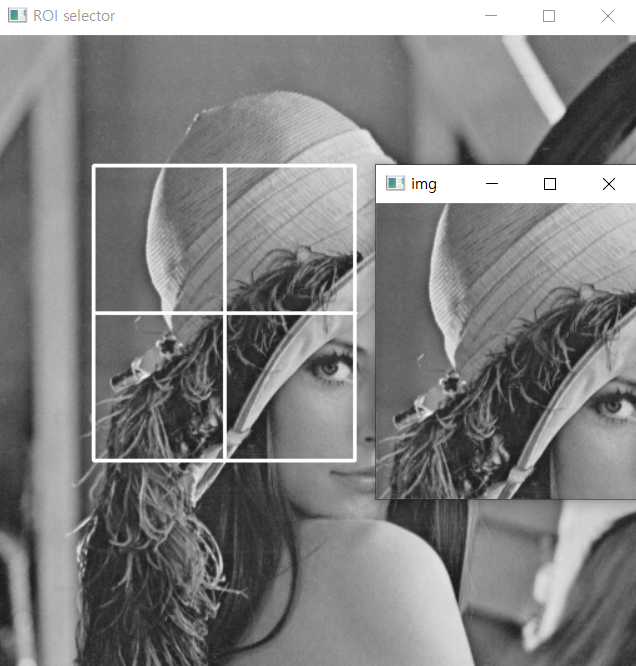
</div>

In [3]:
src = cv2.imread('./data/lena.jpg', cv2.IMREAD_GRAYSCALE)
roi = cv2.selectROI(src)

img = src[roi[1]:roi[1]+roi[3], roi[0]:roi[0]+roi[2]]

cv2.imshow('img', img)
cv2.waitKey()
cv2.destroyAllWindows()

* roi : x, y, width, height

In [45]:
roi

(116, 106, 102, 104)

* 마우스로 다중 ROI 영역 지정 : selectROIs()

In [3]:
src = cv2.imread('./data/lena.jpg', cv2.IMREAD_GRAYSCALE)
rois = cv2.selectROIs('src', src, False, True) # False: 격자 표시 안함, True: 사각형이 중심부터 그려짐

for r in rois:
    cv2.rectangle(src, (r[0], r[1]), (r[0]+r[2], r[1]+r[3]), 255)
    
    
cv2.imshow('src', src)
cv2.waitKey()
cv2.destroyAllWindows()

In [4]:
rois

array([[ 33,  32, 104,  70],
       [167, 114, 138,  86],
       [233, 242, 178, 128]], dtype=int32)

* 블록 평균 영상

* 흑백

In [4]:
src = cv2.imread('./data/lena.jpg', cv2.IMREAD_GRAYSCALE)
dst = np.zeros(src.shape, dtype=src.dtype)

N = 4
height, width = src.shape

h = height // N
w = width // N

for i in range(N):
    for j in range(N):
        x = j*w
        y = i*h
        roi = src[y:y+h, x:x+w]
        dst[y:y+h, x:x+w] = roi.mean()
        
cv2.imshow('dst', dst)
cv2.waitKey()
cv2.destroyAllWindows()

* 컬러

In [5]:
src = cv2.imread('./data/lena.jpg')
dst = np.zeros(src.shape, dtype=src.dtype)

N = 128
height, width= src.shape[:2]

h = height // N
w = width // N

for i in range(N):
    for j in range(N):
        x = j*w
        y = i*h
        roi = src[y:y+h, x:x+w]
        dst[y:y+h, x:x+w, 0] = roi[:, :, 0].mean()
        dst[y:y+h, x:x+w, 1] = roi[:, :, 1].mean()
        dst[y:y+h, x:x+w, 2] = roi[:, :, 2].mean()
        
cv2.imshow('dst', dst)
cv2.waitKey()
cv2.destroyAllWindows()

* 영상 복사

In [6]:
src = cv2.imread('./data/lena.jpg', cv2.IMREAD_GRAYSCALE)

#dst = src       #참조
dst = src.copy() # 복사

dst[100:400, 200:300] = 0

cv2.imshow('src', src)
cv2.imshow('dst', dst)
cv2.waitKey()
cv2.destroyAllWindows()

In [7]:
src = cv2.imread('./data/lena.jpg', cv2.IMREAD_GRAYSCALE)

shape = src.shape[0], src.shape[1], 3
dst = np.zeros(shape, dtype=np.uint8)

# dst[:, :, 0] = src
dst[:, :, 1] = src
dst[:, :, 2] = src

cv2.imshow('src', src)
cv2.imshow('dst', dst)
cv2.waitKey()
cv2.destroyAllWindows()

* 채널 분리

In [32]:
src = cv2.imread('./data/lena.jpg')

In [33]:
dst = cv2.split(src)

In [36]:
len(dst)

3

In [40]:
dst[0].shape #blue channel

(512, 512)

In [41]:
dst[1].shape #green channel

(512, 512)

In [42]:
dst[2].shape #red channel

(512, 512)

In [47]:
cv2.imshow('src', src)
cv2.imshow('blue', dst[0])
cv2.imshow('green', dst[1])
cv2.imshow('red', dst[2])

cv2.waitKey()
cv2.destroyAllWindows()

<div>
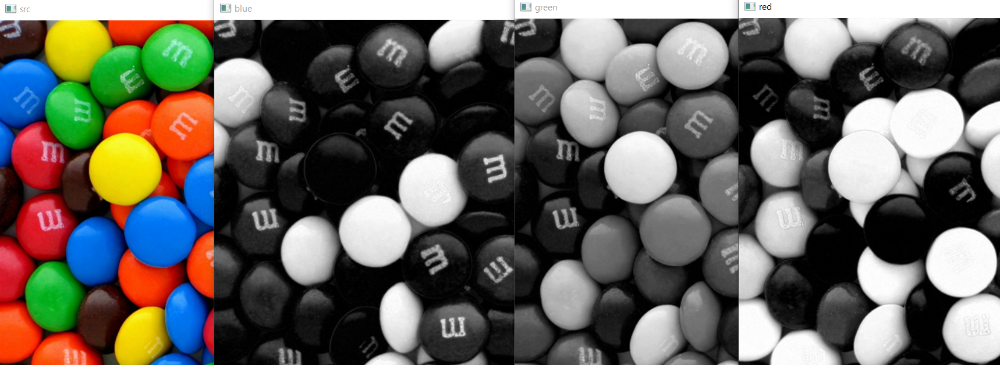
</div>

In [50]:
src = cv2.imread('./data/candies.png')

b, g, r = cv2.split(src)

cv2.imshow('src', src)
cv2.imshow('blue', b)
cv2.imshow('green', g)
cv2.imshow('red', r)

cv2.waitKey()
cv2.destroyAllWindows()

* 채널 병합

In [51]:
merge = cv2.merge([b, g, r])

cv2.imshow('merge', merge)
cv2.waitKey()
cv2.destroyAllWindows()

* 색 변환

In [52]:
src = cv2.imread('./data/lena.jpg')

In [53]:
gray = cv2.cvtColor(src, cv2.COLOR_BGR2GRAY)
yCrCb = cv2.cvtColor(src, cv2.COLOR_BGR2YCrCb)
hsv = cv2.cvtColor(src, cv2.COLOR_BGR2HSV)

<div>
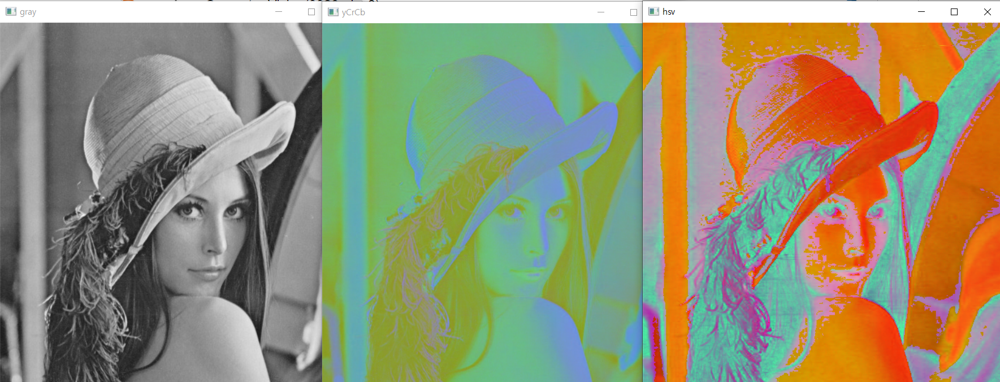
</div>

In [67]:
cv2.imshow('gray', gray)
cv2.imshow('yCrCb', yCrCb)
cv2.imshow('hsv', hsv)

cv2.waitKey()
cv2.destroyAllWindows()

In [55]:
bgr = cv2.cvtColor(gray, cv2.COLOR_GRAY2BGR)
cv2.imshow('bgr', bgr)

cv2.waitKey()
cv2.destroyAllWindows()

In [56]:
bgr.shape

(512, 512, 3)

In [60]:
(bgr[:, :, 2] == gray).sum()

262144

* 영상 크기 변환

In [76]:
src = cv2.imread("./data/lena.jpg", cv2.IMREAD_GRAYSCALE)

In [78]:
dst = cv2.resize(src, dsize=(320, 240))

cv2.imshow('dst', dst)
cv2.waitKey()
cv2.destroyAllWindows()

In [79]:
dst1 = cv2.resize(src, dsize=(320, 240))
dst2 = cv2.resize(src, dsize=(0, 0), fx=1.5, fy=1.2) # 직접 사이즈 지정 안하고 배수로 지정

cv2.imshow('dst1', dst1)
cv2.imshow('dst2', dst2)
cv2.waitKey()
cv2.destroyAllWindows()

* 영상 회전 변환

<div>
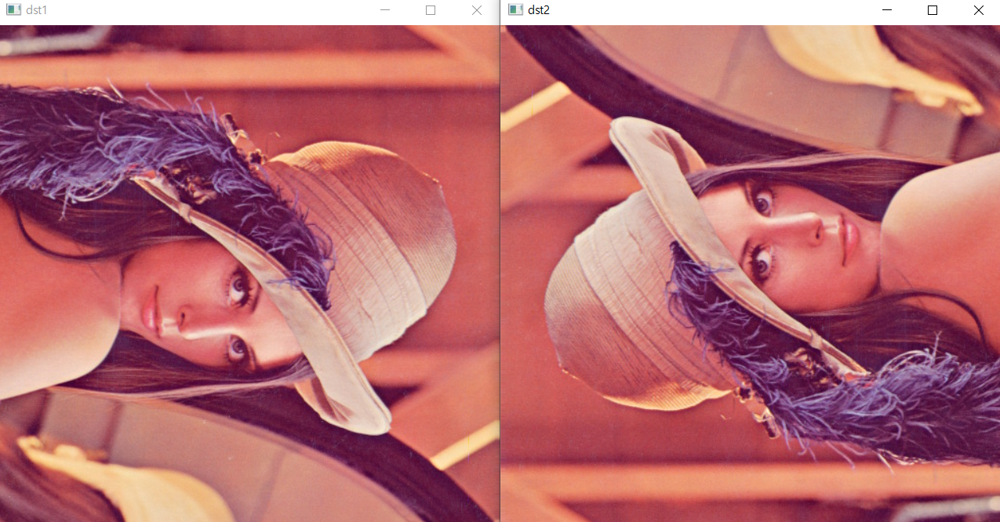
</div>

In [80]:
src = cv2.imread("./data/lena.jpg")

dst1 = cv2.rotate(src, cv2.ROTATE_90_CLOCKWISE)
dst2 = cv2.rotate(src, cv2.ROTATE_90_COUNTERCLOCKWISE)

cv2.imshow('dst1', dst1)
cv2.imshow('dst2', dst2)
cv2.waitKey()
cv2.destroyAllWindows()

<div>
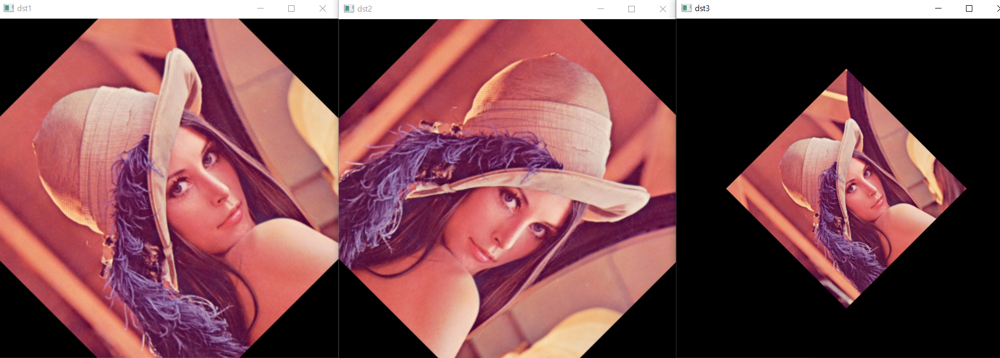
</div>

In [84]:
src = cv2.imread("./data/lena.jpg")

height, width, channels = src.shape

M1 = cv2.getRotationMatrix2D((height/2, width/2), 45, 1)
M2 = cv2.getRotationMatrix2D((height/2, width/2), -45, 1)
M3 = cv2.getRotationMatrix2D((height/2, width/2), 45, 0.5)  # 45도 회전 후 크기 변환

dst1 = cv2.warpAffine(src, M1, (width, height))
dst2 = cv2.warpAffine(src, M2, (width, height))
dst3 = cv2.warpAffine(src, M3, (width, height))

cv2.imshow('dst1', dst1)
cv2.imshow('dst2', dst2)
cv2.imshow('dst3', dst3)
cv2.waitKey()
cv2.destroyAllWindows()

* 영상 어파인 변환(모서리 3점)

<div>
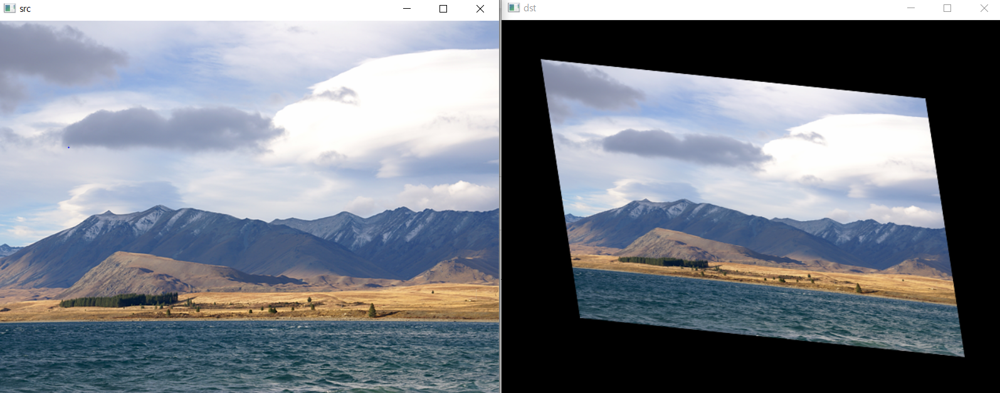
</div>

In [87]:
src = cv2.imread('./data/tekapo.bmp')
height, width, channels = src.shape

srcPts = np.float32([[0, 0], [width-1, 0], [width-1, height-1]])
dstPts = np.float32([[50, 50], [width-100, 100], [width-50, height-50]])

M = cv2.getAffineTransform(srcPts, dstPts)
dst = cv2.warpAffine(src, M, (width, height))

cv2.imshow('src', src)
cv2.imshow('dst', dst)
cv2.waitKey()
cv2.destroyAllWindows()

In [88]:
M.dtype

dtype('float64')

* 영상 이동 변환

<div>
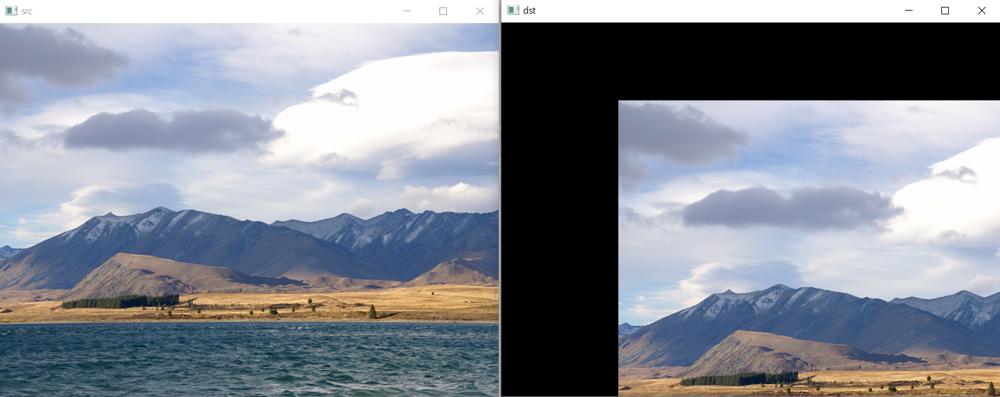
</div>

In [89]:
src = cv2.imread('./data/tekapo.bmp')
height, width, channels = src.shape

M = np.array([[1, 0, 150],
             [0, 1, 100]], dtype=np.float64)

dst = cv2.warpAffine(src, M, (width, height))

cv2.imshow('src', src)
cv2.imshow('dst', dst)
cv2.waitKey()
cv2.destroyAllWindows()

* 영상 대칭 변환

<div>
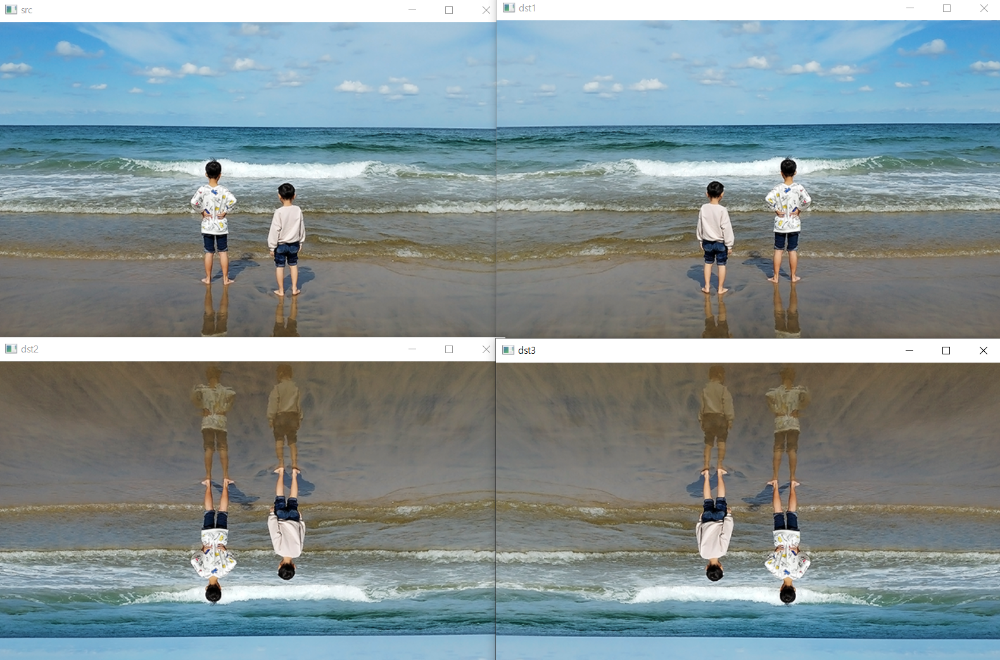
</div>

In [6]:
src = cv2.imread('./data/eastsea.bmp')

dst1 = cv2.flip(src, 1)
dst2 = cv2.flip(src, 0)
dst3 = cv2.flip(src, -1)

cv2.imshow('src', src)
cv2.imshow('dst1', dst1)
cv2.imshow('dst2', dst2)
cv2.imshow('dst3', dst3)
cv2.waitKey()
cv2.destroyAllWindows()

* 1 : 좌우 대칭
* 0 : 상하 대칭
* -1 : 좌우, 상하 대칭

* 영상 투시 변환

In [8]:
cnt = 0

w = 200
h = 300

srcQuad = np.zeros((4, 2), dtype=np.float32)
dstQuad = np.array([[0, 0], [w-1, 0], [w-1, h-1], [0, h-1]], dtype=np.float32)

def onMouse(event, x, y, flags, param):
    global cnt
    
    if event == cv2.EVENT_LBUTTONDOWN:
        if cnt < 4:
            srcQuad[cnt] = np.array([x, y], dtype=np.float32)
            cv2.circle(param[0], (x, y), 5, (255, 0, 0), 2)
            cv2.imshow('src', param[0])
            cnt += 1
            
        if cnt == 4:
            M = cv2.getPerspectiveTransform(srcQuad, dstQuad)
            dst = cv2.warpPerspective(param[0], M, (w, h))
            cv2.imshow('dst', dst)
            
src = cv2.imread('./data/card.bmp')
cv2.imshow('src', src)
cv2.setMouseCallback('src', onMouse, [src])
cv2.waitKey()
cv2.destroyAllWindows()

<div>
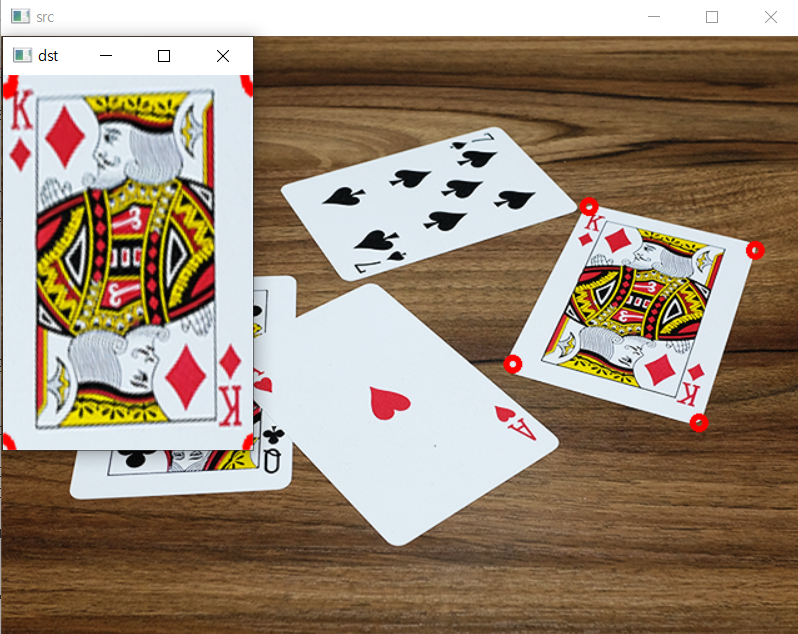
</div>

* 내 코드

In [7]:
src = cv2.imread('./data/card.bmp')

srcPts = np.zeros((4, 2), dtype=np.float32)
cnt = 0
def onMouse(event, x, y, flags, param):
    global cnt
    if event == cv2.EVENT_LBUTTONDOWN:
        cv2.circle(param[0], (x, y), 5, (0, 0, 255), 3)
        srcPts[cnt] = [x, y]
        cnt+= 1
        
        if cnt == 4:
            w = 200
            h = 300
            dstPts = np.float32([[0, 0], [w, 0],
                                [w, h], [0, h]])
            
            M = cv2.getPerspectiveTransform(srcPts, dstPts)

            dst = cv2.warpPerspective(src, M, (w, h))
            cv2.imshow('dst', dst)
            
    cv2.imshow('src', param[0])        

cv2.imshow('src', src)
cv2.setMouseCallback('src', onMouse, [src])
cv2.waitKey()
cv2.destroyAllWindows()